<a href="https://colab.research.google.com/github/PetraB42/DSpracticum2020/blob/main/Buldosers.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

**Sources**

data: https://www.kaggle.com/c/bluebook-for-bulldozers

script:
https://towardsdatascience.com/random-forest-in-python-24d0893d51c0

https://towardsdatascience.com/hyperparameter-tuning-the-random-forest-in-python-using-scikit-learn-28d2aa77dd74


**Prepare data for model**

In [2]:
import pandas as pd
from sklearn.preprocessing import OneHotEncoder
import matplotlib.pyplot as plt
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler
from sklearn.ensemble import RandomForestRegressor

Upload data


In [2]:
from google.colab import files

files.upload() #upload 7z file not csv, faster upload. csv upload takes too long.

Saving TrainAndValid.7z to TrainAndValid.7z


{'TrainAndValid.7z': b'7z\xbc\xaf\'\x1c\x00\x03\x8a\xcbV\xb8t\xf8p\x00\x00\x00\x00\x00h\x00\x00\x00\x00\x00\x00\x00\x0f\xc3\xf4\xd4\x00)\x98I\x86ji\xe0\xf7/\xcc\xee\xd9\x04\x01\x90\x06<\xb1,\xablj\xb1\x9dO\xe8\xf2\xc2D\x83|\xfdc\'o2\xe03\x92\x07\x1b\x90\xcfS\xab@(G\xa9\xd3\xbb?\x8aE@\x1c\x19\xc9\x16\xfd\xae\x9bWy`\xeb\xcep\x1a\x06}>\xe3\xef\xfd\xa0\xeee0\xc3\xabX\x13\xe8\xb8\x84\xaey\x9b\x89\xc4\x19\x12\xc0\xe1\xc1=\xb0P\xcb\x99\xb7t\t\xd5\xc9>1.\xa4:\xc8\xe9\x03\x88<\x9e=\x94BI\x19\x8c\r\x1f\xb4u\x08\x91\xac\'J}4\xc8C9\n\x08\xf4\xafz\xe2\x11\x03\xe7\xf95\xeae\xdb\x9ak\xeb`\xb4[[U\xfd\xec\xd0\xb7\xd4)\xd3\xdb\xdc.\xd0m\xc9g\x80\x12\xef\xe3\xee6y\x18\x9a\x16~77\xb0\x9f\xcb\xfd\xfb\x96e\xdb*{P\x8b\x9f\xeav\x12\xd7\xbd\xcf\xe0\'m\x84\x01\xff\x98\x91\xa9\x91\x15@\x9c)\x02\x1f\xb8T\xd6\xb9e\xa8\xd4\xc9={@\x92$\xb7\xef4[\xdf\x8a\xed\xbd6\x86U9\xb8)\x90\xd4\x1fit\xf6\xb8\xa4\x94D\xdc\x1f\x15\x1b\xecdO,\xb8\xf776\xe4\xef0\x1a\xac\xaa\xf7\x15\xb5\xd8\x82\xf0#\x99\xe7\x96\xb1\xf9;,\xdb=\xc1D"w\x

In [3]:
!apt-get install p7zip-full
!p7zip -d TrainAndValid.7z

Reading package lists... Done
Building dependency tree       
Reading state information... Done
p7zip-full is already the newest version (16.02+dfsg-6).
0 upgraded, 0 newly installed, 0 to remove and 15 not upgraded.
/usr/bin/p7zip: cannot read TrainAndValid.7z


In [4]:
raw = pd.read_csv("TrainAndValid.csv",parse_dates=['saledate'],low_memory=False) 
print('The shape of data is:', raw.shape)

The shape of data is: (412698, 53)


Transofrm saledate into reasonable format


*   Transform date into separate columns for year and month of sale
*   Get rid of the original saledate



In [6]:
raw['saleyear']=raw.saledate.dt.year
raw['salemonth']=raw.saledate.dt.month

raw.drop("saledate", axis=1, inplace=True)

AttributeError: ignored

**Numeric variables**



*   Drop columns with unique value per each row - no predictive value
*   Check and fix missing values 





In [7]:
for i in range(raw.shape[1]):
  if (raw.dtypes[i] == "int64" or raw.dtypes[i] == "float64" ):

    print(raw.columns[i], "contains", raw.nunique()[i],"unique observations with", raw.isna().sum()[i], "missing values")

SalesID contains 412698 unique observations with 0 missing values
SalePrice contains 954 unique observations with 0 missing values
MachineID contains 348808 unique observations with 0 missing values
ModelID contains 5281 unique observations with 0 missing values
datasource contains 6 unique observations with 0 missing values
auctioneerID contains 30 unique observations with 20136 missing values
YearMade contains 73 unique observations with 0 missing values
MachineHoursCurrentMeter contains 15633 unique observations with 265194 missing values
saleyear contains 24 unique observations with 0 missing values
salemonth contains 12 unique observations with 0 missing values


In [8]:
ndf = raw.copy()

ndf.drop(["SalesID"], axis = 1, inplace = True) # no predictive value

ndf["auctioneerID"] = ndf["auctioneerID"].fillna(ndf["auctioneerID"].median()) # missing values will be filled with median for actioner ID 

ndf["MachineHoursCurrentMeter"] = ndf["MachineHoursCurrentMeter"].fillna(0) # missing values will be filled with 0 - anticipating variable left blank for new machines 

**Categorical variables**



*   Drop columns with unique value per each row - no predictive value
*   Check missing values 
*   Transform



In [9]:
cat_drop = []

for item in ndf.columns:
  if ndf.dtypes[item] == "object":
    if ndf[item].isna().sum() > len(ndf[item])*0.05:
      cat_drop.append(item) #gather all variables with more than 5% missing values

red_df = ndf.drop(columns = cat_drop)

In [10]:
for name in red_df.columns: # check if there are any missng values left
  print(name,"contains",(len(red_df[name]) - red_df[name].isna().sum()),
          "observations within ", len(red_df[name].unique()), "categories with ", red_df[item].isna().sum(), "missing values" )

SalePrice contains 412698 observations within  954 categories with  0 missing values
MachineID contains 412698 observations within  348808 categories with  0 missing values
ModelID contains 412698 observations within  5281 categories with  0 missing values
datasource contains 412698 observations within  6 categories with  0 missing values
auctioneerID contains 412698 observations within  30 categories with  0 missing values
YearMade contains 412698 observations within  73 categories with  0 missing values
MachineHoursCurrentMeter contains 412698 observations within  15633 categories with  0 missing values
fiModelDesc contains 412698 observations within  5059 categories with  0 missing values
fiBaseModel contains 412698 observations within  1961 categories with  0 missing values
fiProductClassDesc contains 412698 observations within  74 categories with  0 missing values
state contains 412698 observations within  53 categories with  0 missing values
ProductGroup contains 412698 observati

In [11]:
red_df["Enclosure"] = red_df["Enclosure"].fillna('None or Unspecified') # missing values replacement

red_df = red_df.drop(columns = ["fiModelDesc", "fiBaseModel","fiProductClassDesc", "ProductGroupDesc"]) #drop variables with too many categories; ProductGroupDesc is duplicate with ProductGroup

Asing US states into economy region categories

In [12]:
regions = { "New_England": ["Connecticut", "Maine", "Massachusetts", "New Hampshire", "Rhode Island" , "Vermont"],
"Mideast": ["Delaware", "District of Columbia", "Maryland", "New Jersey", "New York", "Pennsylvania", "Washington DC"],
"Great_Lakes": ["Illinois", "Indiana", "Michigan", "Ohio", "Wisconsin"],
"Plains": ["Iowa", "Kansas", "Minnesota", "Missouri", "Nebraska", "North Dakota", "South Dakota"],
"Southeast": ["Alabama", "Arkansas", "Florida", "Georgia", "Kentucky", "Louisiana", "Mississippi", "North Carolina", "Puerto Rico", "South Carolina", "Tennessee", "Virginia", "West Virginia"],
"Southwest": ["Arizona", "New Mexico", "Oklahoma", "Texas"],
"Rocky_Mountain": ["Colorado", "Idaho", "Montana", "Utah", "Wyoming"],
"Far_West": ["Alaska", "California", "Hawaii", "Nevada", "Oregon", "Washington"]}


def assign_categories(df, col_name, cat_dict):

  for i in range(len(df[col_name])):
    for key, val in cat_dict.items():
      if df[col_name][i] in val:
        df[col_name][i] = key

assign_categories(red_df, "state", regions)

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  app.launch_new_instance()


One_hot_encoding

In [13]:
red_df = pd.get_dummies(red_df)
print(red_df.shape)
red_df.describe()

(412698, 30)


,SalePrice,MachineID,ModelID,datasource,auctioneerID,YearMade,MachineHoursCurrentMeter,saleyear,salemonth,state_Far_West,state_Great_Lakes,state_Mideast,state_New_England,state_Plains,state_Rocky_Mountain,state_Southeast,state_Southwest,state_Unspecified,ProductGroup_BL,ProductGroup_MG,ProductGroup_SSL,ProductGroup_TEX,ProductGroup_TTT,ProductGroup_WL,Enclosure_EROPS,Enclosure_EROPS AC,Enclosure_EROPS w AC,Enclosure_NO ROPS,Enclosure_None or Unspecified,Enclosure_OROPS
count,412698.000000,4.126980e+05,412698.000000,412698.000000,412698.000000,412698.000000,4.126980e+05,412698.000000,412698.000000,412698.000000,412698.000000,412698.000000,412698.000000,412698.000000,412698.000000,412698.000000,412698.000000,412698.000000,412698.000000,412698.000000,412698.000000,412698.000000,412698.000000,412698.000000,412698.000000,412698.000000,412698.000000,412698.000000,412698.000000,412698.000000
mean,31215.181414,1.230061e+06,6947.201828,135.169361,6.361548,1899.049637,1.259165e+03,2004.317382,6.300268,0.134176,0.079014,0.106284,0.040805,0.045205,0.047512,0.376828,0.163391,0.006787,0.197241,0.063625,0.109065,0.252558,0.200103,0.177408,0.343518,0.000044,0.224380,0.000007,0.000814,0.431238
std,23141.743695,4.539533e+05,6280.824982,9.646749,16.763713,292.190243,1.633077e+04,5.821090,3.437276,0.340841,0.269761,0.308201,0.197838,0.207754,0.212731,0.484592,0.369722,0.082104,0.397916,0.244084,0.311721,0.434480,0.400078,0.382014,0.474883,0.006604,0.417174,0.002696,0.028522,0.495250
min,4750.000000,0.000000e+00,28.000000,121.000000,0.000000,1000.000000,0.000000e+00,1989.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,14500.000000,1.088593e+06,3261.000000,132.000000,1.000000,1985.000000,0.000000e+00,2000.000000,3.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,24000.000000,1.284397e+06,4605.000000,132.000000,2.000000,1995.000000,0.000000e+00,2006.000000,6.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,40000.000000,1.478079e+06,8899.000000,136.000000,4.000000,2001.000000,0.000000e+00,2009.000000,9.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,1.000000
max,142000.000000,2.486330e+06,37198.000000,173.000000,99.000000,2014.000000,2.483300e+06,2012.000000,12.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


**Model preparation**

*   Split data into training and test sets
*   Normalze/scale numeric data - optional; not necessary for random forest
*   Check baseline prediction 
*   Prepare model


In [14]:
x = red_df.drop(["SalePrice"], axis=1)
y = red_df["SalePrice"]

X_train, X_test, y_train, y_test = train_test_split(x, y, train_size = 0.8, random_state = 42)

print(X_train.shape, y_train.shape, X_test.shape, y_test.shape )

(330158, 29) (330158,) (82540, 29) (82540,)


scale numerical data

In [15]:
scaler = MinMaxScaler()
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)

baseline  - linear regression 

*   simple model to improve with random forest approach


In [16]:
from sklearn.linear_model import LinearRegression

reg = LinearRegression()
reg.fit(X_train,y_train) # train regression model

print("Linear regression model accuracy is", reg.score(X_train,y_train),
      "on training and", reg.score(X_test,y_test), "on validation dataset")

Linear regression model accuracy is 0.3873921206125648 on training and 0.38977420964973153 on validation dataset


train model

In [17]:
rf = RandomForestRegressor(n_estimators = 150, random_state = 42, verbose = 2)
rf.fit(X_train, y_train)

building tree 1 of 150


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    2.3s remaining:    0.0s


building tree 2 of 150
building tree 3 of 150
building tree 4 of 150
building tree 5 of 150
building tree 6 of 150
building tree 7 of 150
building tree 8 of 150
building tree 9 of 150
building tree 10 of 150
building tree 11 of 150
building tree 12 of 150
building tree 13 of 150
building tree 14 of 150
building tree 15 of 150
building tree 16 of 150
building tree 17 of 150
building tree 18 of 150
building tree 19 of 150
building tree 20 of 150
building tree 21 of 150
building tree 22 of 150
building tree 23 of 150
building tree 24 of 150
building tree 25 of 150
building tree 26 of 150
building tree 27 of 150
building tree 28 of 150
building tree 29 of 150
building tree 30 of 150
building tree 31 of 150
building tree 32 of 150
building tree 33 of 150
building tree 34 of 150
building tree 35 of 150
building tree 36 of 150
building tree 37 of 150
building tree 38 of 150
building tree 39 of 150
building tree 40 of 150
building tree 41 of 150
building tree 42 of 150
building tree 43 of 150


[Parallel(n_jobs=1)]: Done 150 out of 150 | elapsed:  5.7min finished


RandomForestRegressor(bootstrap=True, ccp_alpha=0.0, criterion='mse',
                      max_depth=None, max_features='auto', max_leaf_nodes=None,
                      max_samples=None, min_impurity_decrease=0.0,
                      min_impurity_split=None, min_samples_leaf=1,
                      min_samples_split=2, min_weight_fraction_leaf=0.0,
                      n_estimators=150, n_jobs=None, oob_score=False,
                      random_state=42, verbose=2, warm_start=False)

test model

In [18]:
rf.score(X_train,y_train)

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done 150 out of 150 | elapsed:   22.7s finished


0.9832571055587714

In [19]:
def evaluate(model, test_features, test_labels):
    predictions = model.predict(test_features)
    errors = abs(predictions - test_labels)
    mape = 100 * np.mean(errors / test_labels)
    accuracy = 100 - mape
    print('Model Performance')
    print('Average Error: {:0.4f} degrees.'.format(np.mean(errors)))
    print('Accuracy = {:0.2f}%.'.format(accuracy))
    
    return accuracy

evaluate(rf, X_test, y_test)

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s


Model Performance
Average Error: 4960.4522 degrees.
Accuracy = 81.63%.


[Parallel(n_jobs=1)]: Done 150 out of 150 | elapsed:    6.2s finished


81.62925557913553

check importance of individual variables

In [21]:
vars_list = list(x.columns)

In [24]:
low_importance = []

importances = list(rf.feature_importances_) # Get numerical feature importances
feature_importances = [(feature, round(importance, 2)) for feature, importance in zip(vars_list, importances)] # List of tuples with variable and importance
feature_importances = sorted(feature_importances, key = lambda x: x[1], reverse = True) # Sort the feature importances by most important first

[print('Variable: {:20} Importance: {}'.format(*pair)) for pair in feature_importances]; 

for feature, importance in zip(vars_list, importances): # select features with importance below 0.05
  if importance < 0.05:
    low_importance.append(feature)


Variable: ModelID              Importance: 0.26
Variable: Enclosure_EROPS w AC Importance: 0.23
Variable: YearMade             Importance: 0.15
Variable: saleyear             Importance: 0.08
Variable: ProductGroup_SSL     Importance: 0.06
Variable: MachineID            Importance: 0.04
Variable: ProductGroup_BL      Importance: 0.04
Variable: ProductGroup_MG      Importance: 0.03
Variable: salemonth            Importance: 0.02
Variable: auctioneerID         Importance: 0.01
Variable: MachineHoursCurrentMeter Importance: 0.01
Variable: ProductGroup_TEX     Importance: 0.01
Variable: ProductGroup_TTT     Importance: 0.01
Variable: ProductGroup_WL      Importance: 0.01
Variable: datasource           Importance: 0.0
Variable: state_Far_West       Importance: 0.0
Variable: state_Great_Lakes    Importance: 0.0
Variable: state_Mideast        Importance: 0.0
Variable: state_New_England    Importance: 0.0
Variable: state_Plains         Importance: 0.0
Variable: state_Rocky_Mountain Importance:

**Adjust model**

drop unimportant variables and run the model again

In [29]:
x_red = red_df.drop(columns = low_importance)

X_train_red, X_test_red = train_test_split(x_red, train_size = 0.8, random_state = 42)

X_train_red = scaler.fit_transform(X_train_red)
X_test_red = scaler.transform(X_test_red)

print(X_train_red.shape, y_train.shape, X_test_red.shape, y_test.shape )

(330158, 6) (330158,) (82540, 6) (82540,)


In [32]:
rf_new = RandomForestRegressor(n_estimators = 150, random_state = 42, verbose = 2)

rf_new.fit(X_train_red, y_train)
rf_new.score(X_train_red,y_train)

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


building tree 1 of 150


[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.4s remaining:    0.0s


building tree 2 of 150
building tree 3 of 150
building tree 4 of 150
building tree 5 of 150
building tree 6 of 150
building tree 7 of 150
building tree 8 of 150
building tree 9 of 150
building tree 10 of 150
building tree 11 of 150
building tree 12 of 150
building tree 13 of 150
building tree 14 of 150
building tree 15 of 150
building tree 16 of 150
building tree 17 of 150
building tree 18 of 150
building tree 19 of 150
building tree 20 of 150
building tree 21 of 150
building tree 22 of 150
building tree 23 of 150
building tree 24 of 150
building tree 25 of 150
building tree 26 of 150
building tree 27 of 150
building tree 28 of 150
building tree 29 of 150
building tree 30 of 150
building tree 31 of 150
building tree 32 of 150
building tree 33 of 150
building tree 34 of 150
building tree 35 of 150
building tree 36 of 150
building tree 37 of 150
building tree 38 of 150
building tree 39 of 150
building tree 40 of 150
building tree 41 of 150
building tree 42 of 150
building tree 43 of 150


[Parallel(n_jobs=1)]: Done 150 out of 150 | elapsed:   60.0s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done 150 out of 150 | elapsed:    4.1s finished


0.999999997211103

In [33]:
evaluate(rf_new, X_test_red, y_test)

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s


Model Performance
Average Error: 0.1023 degrees.
Accuracy = 100.00%.


[Parallel(n_jobs=1)]: Done 150 out of 150 | elapsed:    1.0s finished


99.99965363004875

visualise tree

In [35]:
features = x_red.columns

from sklearn.tree import export_graphviz
import pydot

tree = rf.estimators_[2] # Pull out one tree from the forest
# Export the image to a dot file
export_graphviz(tree, out_file = 'tree.dot', feature_names = features, rounded = True, precision = 1)
(graph, ) = pydot.graph_from_dot_file('tree.dot')# Use dot file to create a graph
graph.write_png('tree.png')# Write graph to a png file

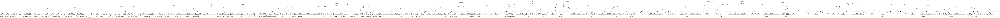

In [36]:
from IPython.display import Image
Image(filename = 'tree.png')